# Problem Statement
A consumer bank with a range of products would like to cross-sell insurance to its consumer base (that is, cross-sell the personal protection insurance (PPI) product to those customers who have a secured or unsecured type of loan, but no PPI product as yet). 
Attached is a sample data set from their customer portfolio containing various fields about their product ownership, credit standing, outstanding amounts, and whether they already have an insurance product (called as PPI / personal protection insurance), if any, the type of PPI product they own.
The bank would like to adopt analytics driven approach applied on this sample data for deciding:
-	Who should they target from the pool of customers that currently do not have a PPI, and 
-	What type of PPI product they should be targeting them with..
Using the attached sample data, please come up with your analytics approach, detailing the following in a PowerPoint presentation format:
-	Your understanding of the different data fields 
o	Note: No further information is available on data field descriptions etc. You could make smart assumptions about what the fields mean, and call out such assumptions.

-	Present snippets of the analytics you performed with the data (feel free to build any model / models if you think it is relevant, but you don’t have to necessarily build a model. We will be interested in the quality of insights you have to provide)

-	How you would use the results of the analysis in designing a simple, but effective strategy to achieve the goal of cross-sell

-	How would you measure the improvement driven by the approach?
 


In [155]:
#Read file
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
df=pd.read_excel('Case study excel file.xls')
pd.set_option("display.max_rows", None, "display.max.columns", None)
pd.set_option("display.max_colwidth", None)

In [156]:
df.head()

,Ref,Credit_Score,Final_Grade,Term,Net_Advance,APR,Loan_Type,Mosaic,Mosaic_Class,Time_at_Address,Residential_Status,Telephone_Indicator,Number_of_Dependants,Marital_Status,Gender,Time_in_Employment,Employment_Status,Full_Part_Time_Empl_Ind,Perm_Temp_Empl_Ind,Income_Range,Current_Account,ACCESS_Card,VISA_Card,American_Express,Diners_Card,Cheque_Guarantee,Other_Credit_Store_Card,Time_with_Bank,Value_of_Property,Outstanding_Mortgage_Bal,Total_Outstanding_Balances,Bureau_Data___Monthly_Other_Co_R,Worst_History_CT,Payment_Method,Age,Total_outstanding_balance__mortg,Total___Public_Info___CCJ____ban,Total_value__Public_Info___CCJ__,Time_since_most_recent_Public_In,Total_value__CAIS_8_9s,Worst_status_L6m,Worst_CUrrent_Status,__of_status_3_s_L6m,Searches___Total___L6m,Years_on_ER_for_SP,Bankruptcy_Detected__SP_,Total___outstanding_CCJ_s,Total_outstanding_balance___excl,Total___of_accounts,CIFAS_detected,Time_since_most_recent_outstandi,Insurance_Description,PPI,code,prdt_desc,category,PPI_SINGLE,PPI_JOINT,PPI_LCI
0,1,918,A,36,3000.0,14.4,UnSecured,46,8,132,H,Y,0,M,M,288,S,F,P,6,TRUE,FALSE,FALSE,FALSE,FALSE,TRUE,TRUE,168,178000,47679,64406,513,5,D,46,64,1,5,16,0,0,0,0,9,10,N,1,18,6,N,16,NaN,0,NaN,NaN,NaN,0,0,0
1,3,903,A,120,21000.0,7.9,secured,16,3,288,H,Y,0,S,F,37,R,P,P,2,TRUE,FALSE,TRUE,FALSE,FALSE,TRUE,FALSE,300,180000,11563,31614,331,5,D,59,13,0,0,99,0,1,0,0,6,22,N,0,203,8,N,99,Life & Critical Illn,1,748.0,LIFE & CRITICAL ILLNESS,LCI,0,0,1
2,4,1060,X,78,7200.0,7.9,secured,17,3,276,H,Y,0,M,M,154,P,F,P,5,TRUE,FALSE,TRUE,FALSE,FALSE,TRUE,FALSE,369,199000,17563,26045,413,0,D,56,19,2,30,50,266,0,0,0,1,21,N,1,87,7,N,50,Joint,1,719.0,LASCI JOINT,Joint,0,1,0
3,6,839,B,60,8000.0,16.9,UnSecured,47,8,48,R,Y,0,M,M,82,G,F,P,6,TRUE,FALSE,TRUE,FALSE,FALSE,TRUE,FALSE,216,120000,0,181217,1112,5,D,33,160,0,0,99,1,1,0,0,5,0,N,0,229,9,N,99,Life & Critical Illn,1,748.0,LIFE & CRITICAL ILLNESS,LCI,0,0,1
4,7,1057,X,60,7650.0,7.4,UnSecured,55,10,156,H,Y,2,M,M,342,S,F,P,6,TRUE,TRUE,FALSE,FALSE,FALSE,TRUE,FALSE,510,180000,60101,63811,435,0,D,49,62,0,0,99,0,0,0,0,1,13,N,0,38,6,N,99,Single,1,718.0,LASCI,Single,1,0,0


In [157]:
#finding out the shape of the data using "shape" variable: Output (rows, columns)
df.shape

(16383, 59)

In [158]:
#Printing all the columns present in data
df.columns

Index(['Ref', 'Credit_Score', 'Final_Grade', 'Term', 'Net_Advance', 'APR',
       'Loan_Type', 'Mosaic', 'Mosaic_Class', 'Time_at_Address',
       'Residential_Status', 'Telephone_Indicator', 'Number_of_Dependants',
       'Marital_Status', 'Gender', 'Time_in_Employment', 'Employment_Status',
       'Full_Part_Time_Empl_Ind', 'Perm_Temp_Empl_Ind', 'Income_Range',
       'Current_Account', 'ACCESS_Card', 'VISA_Card', 'American_Express',
       'Diners_Card', 'Cheque_Guarantee', 'Other_Credit_Store_Card',
       'Time_with_Bank', 'Value_of_Property', 'Outstanding_Mortgage_Bal',
       'Total_Outstanding_Balances', 'Bureau_Data___Monthly_Other_Co_R',
       'Worst_History_CT', 'Payment_Method', 'Age',
       'Total_outstanding_balance__mortg', 'Total___Public_Info___CCJ____ban',
       'Total_value__Public_Info___CCJ__', 'Time_since_most_recent_Public_In',
       'Total_value__CAIS_8_9s', 'Worst_status_L6m', 'Worst_CUrrent_Status',
       '__of_status_3_s_L6m', 'Searches___Total___L6m', '

## Variable Identification and Typecasting

In [159]:
df.dtypes

Ref                                   int64
Credit_Score                          int64
Final_Grade                          object
Term                                  int64
Net_Advance                         float64
APR                                 float64
Loan_Type                            object
Mosaic                                int64
Mosaic_Class                          int64
Time_at_Address                       int64
Residential_Status                   object
Telephone_Indicator                  object
Number_of_Dependants                  int64
Marital_Status                       object
Gender                               object
Time_in_Employment                    int64
Employment_Status                    object
Full_Part_Time_Empl_Ind              object
Perm_Temp_Empl_Ind                   object
Income_Range                          int64
Current_Account                      object
ACCESS_Card                          object
VISA_Card                       

### Integer Data Type

In [84]:
#Checking distribution of null data type
df.isnull().sum()/len(df)*100

Ref                                  0.000000
Credit_Score                         0.000000
Final_Grade                          0.000000
Term                                 0.000000
Net_Advance                          0.000000
APR                                  0.000000
Loan_Type                            0.000000
Mosaic                               0.000000
Mosaic_Class                         0.000000
Time_at_Address                      0.000000
Residential_Status                   0.000000
Telephone_Indicator                  0.000000
Number_of_Dependants                 0.000000
Marital_Status                       0.000000
Gender                               0.000000
Time_in_Employment                   0.000000
Employment_Status                    0.000000
Full_Part_Time_Empl_Ind              0.000000
Perm_Temp_Empl_Ind                   0.000000
Income_Range                         0.000000
Current_Account                      0.000000
ACCESS_Card                       

In [169]:
# Identifying variables with int datatype
# Numerical datatypes
df.select_dtypes(include=['int64','float64','Int64']).dtypes.index

Index(['Ref', 'Credit_Score', 'Term', 'Net_Advance', 'APR', 'Mosaic',
       'Mosaic_Class', 'Time_at_Address', 'Number_of_Dependants',
       'Time_in_Employment', 'Income_Range', 'Time_with_Bank',
       'Value_of_Property', 'Outstanding_Mortgage_Bal',
       'Total_Outstanding_Balances', 'Bureau_Data___Monthly_Other_Co_R',
       'Worst_History_CT', 'Age', 'Total_outstanding_balance__mortg',
       'Total___Public_Info___CCJ____ban', 'Total_value__Public_Info___CCJ__',
       'Time_since_most_recent_Public_In', 'Total_value__CAIS_8_9s',
       'Worst_status_L6m', 'Worst_CUrrent_Status', '__of_status_3_s_L6m',
       'Searches___Total___L6m', 'Years_on_ER_for_SP',
       'Total___outstanding_CCJ_s', 'Total_outstanding_balance___excl',
       'Total___of_accounts', 'Time_since_most_recent_outstandi', 'PPI',
       'code', 'PPI_SINGLE', 'PPI_JOINT', 'PPI_LCI'],
      dtype='object')

In [20]:
df.head()

,Ref,Credit_Score,Final_Grade,Term,Net_Advance,APR,Loan_Type,Mosaic,Mosaic_Class,Time_at_Address,Residential_Status,Telephone_Indicator,Number_of_Dependants,Marital_Status,Gender,Time_in_Employment,Employment_Status,Full_Part_Time_Empl_Ind,Perm_Temp_Empl_Ind,Income_Range,Current_Account,ACCESS_Card,VISA_Card,American_Express,Diners_Card,Cheque_Guarantee,Other_Credit_Store_Card,Time_with_Bank,Value_of_Property,Outstanding_Mortgage_Bal,Total_Outstanding_Balances,Bureau_Data___Monthly_Other_Co_R,Worst_History_CT,Payment_Method,Age,Total_outstanding_balance__mortg,Total___Public_Info___CCJ____ban,Total_value__Public_Info___CCJ__,Time_since_most_recent_Public_In,Total_value__CAIS_8_9s,Worst_status_L6m,Worst_CUrrent_Status,__of_status_3_s_L6m,Searches___Total___L6m,Years_on_ER_for_SP,Bankruptcy_Detected__SP_,Total___outstanding_CCJ_s,Total_outstanding_balance___excl,Total___of_accounts,CIFAS_detected,Time_since_most_recent_outstandi,Insurance_Description,PPI,code,prdt_desc,category,PPI_SINGLE,PPI_JOINT,PPI_LCI
0,1,918,A,36,3000.0,14.4,UnSecured,46,8,132,H,Y,0,M,M,288,S,F,P,6,TRUE,FALSE,FALSE,FALSE,FALSE,TRUE,TRUE,168,178000,47679,64406,513,5,D,46,64,1,5,16,0,0,0,0,9,10,N,1,18,6,N,16,NaN,0,NaN,NaN,NaN,0,0,0
1,3,903,A,120,21000.0,7.9,secured,16,3,288,H,Y,0,S,F,37,R,P,P,2,TRUE,FALSE,TRUE,FALSE,FALSE,TRUE,FALSE,300,180000,11563,31614,331,5,D,59,13,0,0,99,0,1,0,0,6,22,N,0,203,8,N,99,Life & Critical Illn,1,748.0,LIFE & CRITICAL ILLNESS,LCI,0,0,1
2,4,1060,X,78,7200.0,7.9,secured,17,3,276,H,Y,0,M,M,154,P,F,P,5,TRUE,FALSE,TRUE,FALSE,FALSE,TRUE,FALSE,369,199000,17563,26045,413,0,D,56,19,2,30,50,266,0,0,0,1,21,N,1,87,7,N,50,Joint,1,719.0,LASCI JOINT,Joint,0,1,0
3,6,839,B,60,8000.0,16.9,UnSecured,47,8,48,R,Y,0,M,M,82,G,F,P,6,TRUE,FALSE,TRUE,FALSE,FALSE,TRUE,FALSE,216,120000,0,181217,1112,5,D,33,160,0,0,99,1,1,0,0,5,0,N,0,229,9,N,99,Life & Critical Illn,1,748.0,LIFE & CRITICAL ILLNESS,LCI,0,0,1
4,7,1057,X,60,7650.0,7.4,UnSecured,55,10,156,H,Y,2,M,M,342,S,F,P,6,TRUE,TRUE,FALSE,FALSE,FALSE,TRUE,FALSE,510,180000,60101,63811,435,0,D,49,62,0,0,99,0,0,0,0,1,13,N,0,38,6,N,99,Single,1,718.0,LASCI,Single,1,0,0


In [165]:
# Identifying variables with object datatype
df.dtypes[df.dtypes == 'object'].index

Index(['Final_Grade', 'Loan_Type', 'Residential_Status', 'Telephone_Indicator',
       'Marital_Status', 'Gender', 'Employment_Status',
       'Full_Part_Time_Empl_Ind', 'Perm_Temp_Empl_Ind', 'Current_Account',
       'ACCESS_Card', 'VISA_Card', 'American_Express', 'Diners_Card',
       'Cheque_Guarantee', 'Other_Credit_Store_Card', 'Payment_Method',
       'Bankruptcy_Detected__SP_', 'CIFAS_detected', 'Insurance_Description',
       'prdt_desc', 'category'],
      dtype='object')

In [172]:
# seggregating variables into groups
customer_details_cat = ['Final_Grade','Loan_Type',
                   'Residential_Status','Telephone_Indicator','Telephone_Indicator',
                   'Number_of_Dependants','Marital_Status','Gender','Employment_Status',
                   'Full_Part_Time_Empl_Ind','Perm_Temp_Empl_Ind','Current_Account',
                    'Worst_status_L6m','Worst_CUrrent_Status',
                    '__of_status_3_s_L6m','Searches___Total___L6m','Bankruptcy_Detected__SP_','Total___of_accounts','CIFAS_detected','Years_on_ER_for_SP','Time_since_most_recent_outstandi'
                   ]

customer_details_cont = ['Ref','APR','Term','Mosaic','Mosaic_Class',
                   'Time_at_Address','Time_in_Employment','Income_Range',
                   'Time_with_Bank','Age','Time_since_most_recent_Public_In','Credit_Score','code'
                   ]

customer_product = ['Insurance_Description','PPI','prdt_desc','category','PPI_SINGLE','PPI_JOINT','PPI_LCI']

customer_card=['ACCESS_Card','VISA_Card','American_Express','Diners_Card','Cheque_Guarantee','Other_Credit_Store_Card']

customer_amount = ['Net_Advance','Value_of_Property','Outstanding_Mortgage_Bal','Total_Outstanding_Balances',
               'Total_outstanding_balance__mortg','Total___Public_Info___CCJ____ban','Total_value__Public_Info___CCJ__',
              'Total_value__CAIS_8_9s','Total___outstanding_CCJ_s','Total_outstanding_balance___excl'
              ]

# Variable selection for categorical variables using hypothesis testing

In [173]:

def BVA_categorical_plot(data, tar, cat):
  '''
  take data and two categorical variables,
  calculates the chi2 significance between the two variables 
  and prints the result with countplot & CrossTab
  '''
  #isolating the variables
  data = data[[cat,tar]][:]

  #forming a crosstab
  table = pd.crosstab(data[tar],data[cat],)
  f_obs = np.array([table.iloc[0][:].values,
                    table.iloc[1][:].values])

  #performing chi2 test
  from scipy.stats import chi2_contingency
  chi, p, dof, expected = chi2_contingency(f_obs)
  
  #checking whether results are significant
  if p<0.05:
    sig = True
  else:
    sig = False

  #plotting grouped plot
  sns.countplot(x=cat, hue=tar, data=data)
  plt.title("p-value = {}\n difference significant? = {}\n".format(round(p,8),sig))

  #plotting percent stacked bar plot
  #sns.catplot(ax, kind='stacked')
  ax1 = data.groupby(cat)[tar].value_counts(normalize=True).unstack()
  ax1.plot(kind='bar', stacked='True',title=str(ax1))
  int_level = data[cat].value_counts()

/Users/3482520/opt/anaconda3/lib/python3.8/site-packages/pandas/plotting/_matplotlib/core.py:337: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


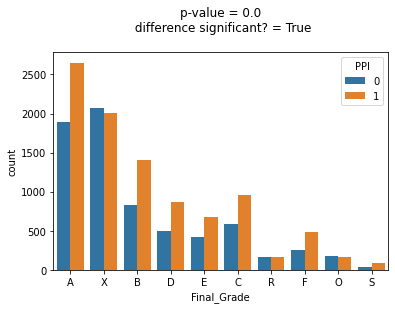

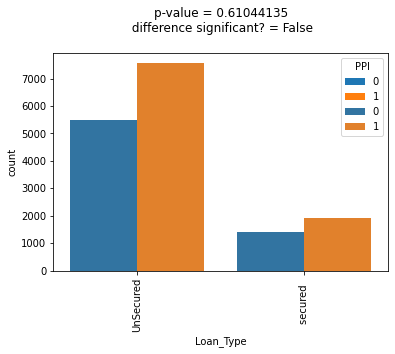

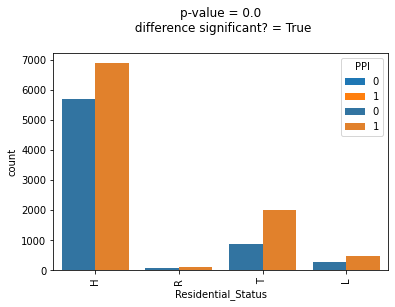

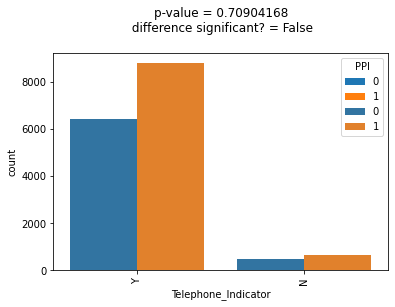

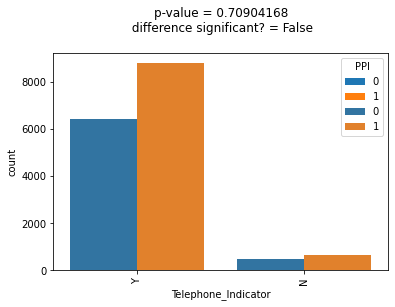

...

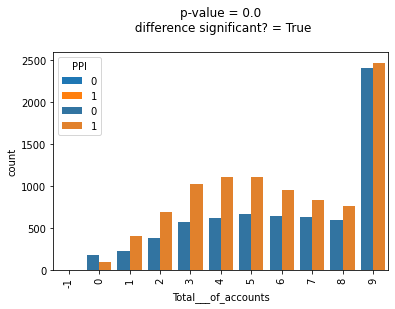

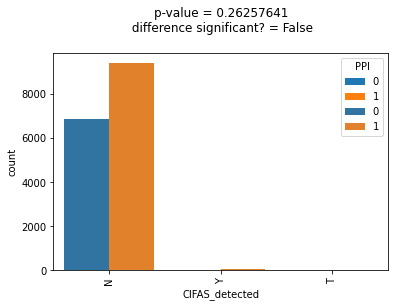

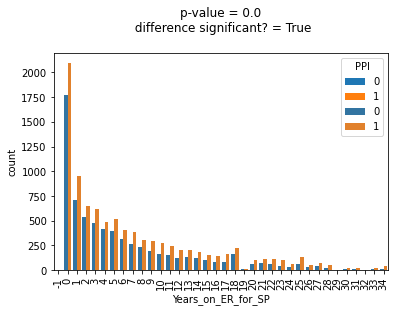

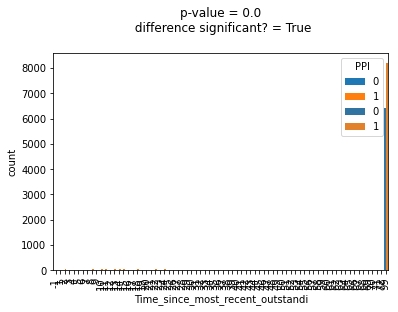

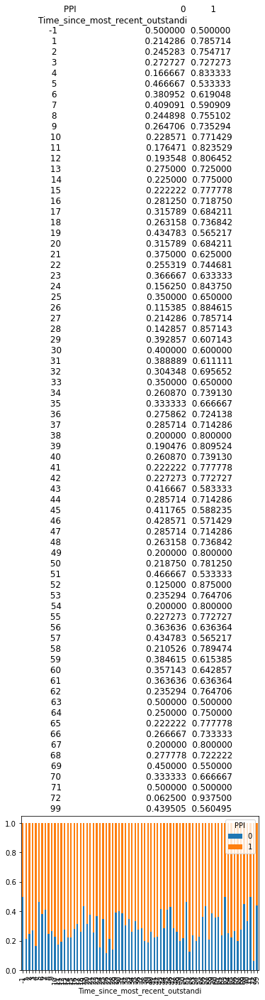

In [174]:
for i in customer_details_cat:
    BVA_categorical_plot(df, 'PPI', i)

#Rule1:EDA
#By sseing above graph we can define different rules for PPI=0 customer like :
1.count of customers with grade A,X,B,D,E,C having PPI plan is more so we can target these customers to sell PPI plan
2.count of customer with residential status H having PPI plan is more
3.count of customer with number of dependant 0,1,2 having PPI plan is more
4.count of customer with marital status M and S having PPI plan is more
5.count of customer with Gender=Male having PPI plan is more
6.count of customer with employment status= P & Ghaving PPI plan is more
7.count of customer with Worst_status_L6m,Worst_CUrrent_Status,__of_status_3_s_L6m with value =0 having PPI plan is more
8.count of customer with Searches___Total___L6m with value=1,2,3 having PPI plan is more
9.count of customer with Total___of_accounts with value=9 having PPI plan is more
10.count of customer with Years_on_ER_for_SP with value between 0-19 having PPI plan is more

# by seeing above hypothesis for customer_details_cat categorical variable we can summarize that below variables out of total customer categorical variables are relevant:
    1.Final_Grade
    2.Residential_Status
    3.Number_of_Dependants
    4.Marital_Status
    5.Gender
    6.Employment_Status
    7.Worst_status_L6m
    8.Worst_CUrrent_Status
    9.__of_status_3_s_L6m
    10.Searches___Total___L6m
    11.Total___of_accounts
    12.Years_on_ER_for_SP
    13.Time_since_most_recent_outstandi
    

In [175]:
customer_details_cat = ['Final_Grade','Residential_Status','Number_of_Dependants','Marital_Status','Gender','Employment_Status','Worst_status_L6m',
                        'Worst_CUrrent_Status','__of_status_3_s_L6m','Searches___Total___L6m','Total___of_accounts','Years_on_ER_for_SP','Time_since_most_recent_outstandi']

In [176]:
customer_product = ['Insurance_Description','prdt_desc','category','PPI_SINGLE','PPI_JOINT','PPI_LCI']
table = pd.crosstab(df['PPI'],df['Insurance_Description'],)
table

Insurance_Description,1st Cust - LASCI / 2,1st Cust - LASU / 2n,1st Cust LASCI / 2nd,1st Cust LASU / 2nd,1st Cust-LASCI /2nd,1st Cust-LASU/ 2nd C,Bronze,Foundation,Gold,JOINT LASCI,JOINT LASU,JOINT LIFE & CRITICA,Joint,Joint Life & Critica,LASCI,LASU,LIFE & CRITICAL ILLN,Life & CI,Life & Critical Illn,Other,Plus,Select,Silver,Single
PPI,,,,,,,,,,,,,,,,,,,,,,,,
1,57,200,10,8,12,42,8,5,63,39,159,283,989,68,717,2351,1025,795,248,495,23,8,7,1849


# by seeing the bahaviour we can conclude that 'Insurance_Description','prdt_desc','category' have missing value for PPI WITH 0 value that means these fields get updated once someone has taken PPI plan and can be dropped from data set because it can be used to suggest type of PPI plan to be sold to customer but not for identifying customer to be targeted for PPI plan


In [177]:
customer_product = ['PPI_SINGLE','PPI_JOINT','PPI_LCI']

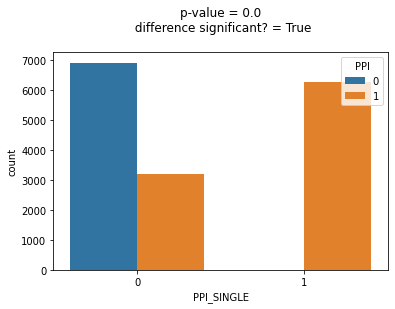

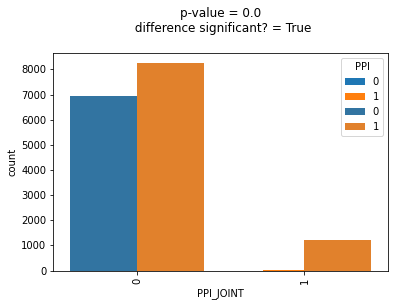

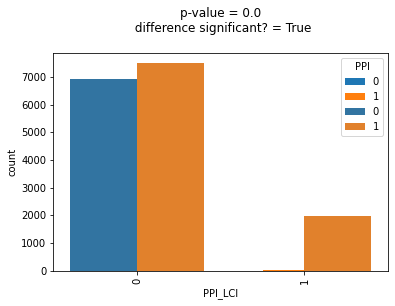

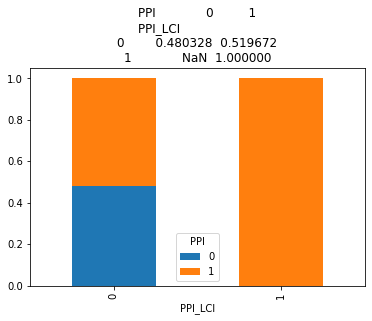

In [178]:
for i in customer_product:
    BVA_categorical_plot(df, 'PPI', i)

#rule2 EDA:
1.count of customers with PPI_SINGLE=1 is more so we can target these customers to sell PPI plan
2.count of customer with PPI_JOINT=0 having PPI plan is more
3.count of customer with PI_LCI=0 having PPI plan is more

# by seeing above hypothesis for customer_product categorical variable we can summarize that below variables out of total customer categorical variables are relevant:
    1.PPI_SINGLE
    2.PPI_JOINT
    3.PPI_LCI

In [179]:
customer_product = ['PPI_SINGLE','PPI_JOINT','PPI_LCI']

In [180]:

customer_card=['ACCESS_Card','VISA_Card','American_Express','Diners_Card','Cheque_Guarantee','Other_Credit_Store_Card']

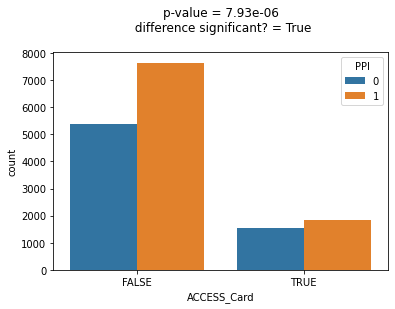

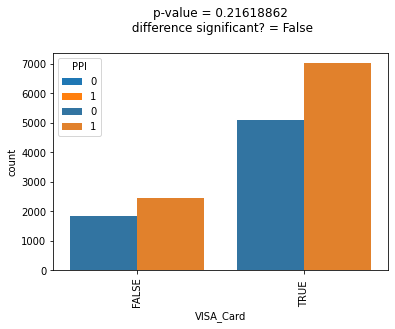

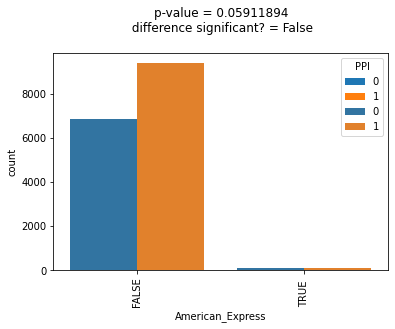

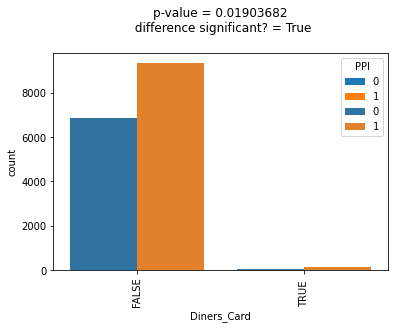

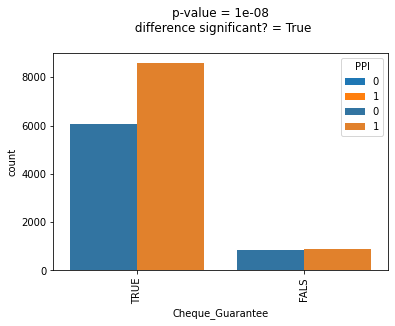

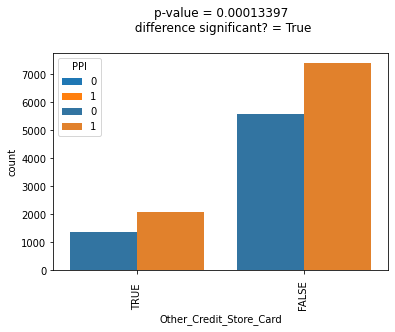

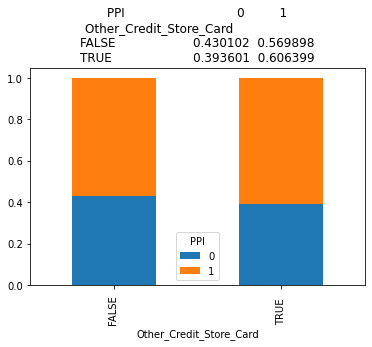

In [181]:
for i in customer_card:
    BVA_categorical_plot(df, 'PPI', i)

In [ ]:
#rule3 EDA:
1.count of customers with ACCESS_Card=False is more so we can target these customers to sell PPI plan
2.count of customer with Diners_Card=False having PPI plan is more
3.count of customer with Cheque_Guarantee=True having PPI plan is more
4.count of customer with Other_Credit_Store_Card=False having PPI plan is more

# by seeing above hypothesis for customer_card below variables are relevant with PPI :
    1.ACCESS_Card
    2.Diners_Card
    3.Cheque_Guarantee
    4.Other_Credit_Store_Card


In [182]:

customer_card=['ACCESS_Card','Diners_Card','Cheque_Guarantee','Other_Credit_Store_Card']

# Variable selection for continous variables using hypothesis testing: Bivariate Analysis : Numerical-Numerical

In [183]:
customer_details_cont = ['Ref','APR','Term','Mosaic','Mosaic_Class',
                   'Time_at_Address','Time_in_Employment','Income_Range',
                   'Time_with_Bank','Age','Time_since_most_recent_Public_In','Credit_Score','code'
                   ]

In [184]:
df.loc[:,customer_details_cont].dtypes

Ref                                   int64
APR                                 float64
Term                                  int64
Mosaic                                int64
Mosaic_Class                          int64
Time_at_Address                       int64
Time_in_Employment                    int64
Income_Range                          int64
Time_with_Bank                        int64
Age                                   int64
Time_since_most_recent_Public_In      int64
Credit_Score                          int64
code                                float64
dtype: object

In [185]:
cor_df1=df.loc[:,customer_details_cont].corr()

In [186]:
cor_df1>0.5

,Ref,APR,Term,Mosaic,Mosaic_Class,Time_at_Address,Time_in_Employment,Income_Range,Time_with_Bank,Age,Time_since_most_recent_Public_In,Credit_Score,code
Ref,True,False,False,False,False,False,False,False,False,False,False,False,True
APR,False,True,False,False,False,False,False,False,False,False,False,False,False
Term,False,False,True,False,False,False,False,False,False,False,False,False,False
Mosaic,False,False,False,True,True,False,False,False,False,False,False,False,False
Mosaic_Class,False,False,False,True,True,False,False,False,False,False,False,False,False
Time_at_Address,False,False,False,False,False,True,False,False,False,False,False,False,False
Time_in_Employment,False,False,False,False,False,False,True,False,False,False,False,False,False
Income_Range,False,False,False,False,False,False,False,True,False,False,False,False,False
Time_with_Bank,False,False,False,False,False,False,False,False,True,False,False,False,False
Age,False,False,False,False,False,False,False,False,False,True,False,False,False


# ref and code are hihly co-related and since ref is unique id both variable can be removed
# mosaic and mosaic_class are highly corelated


In [187]:
customer_details_cont = ['APR','Term','Mosaic',
                   'Time_at_Address','Time_in_Employment','Income_Range',
                   'Time_with_Bank','Age','Time_since_most_recent_Public_In','Credit_Score']

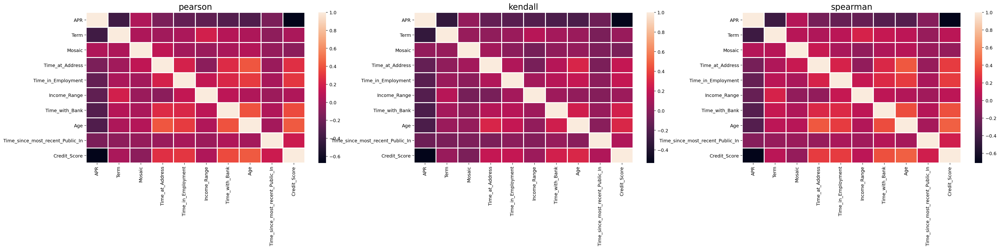

In [188]:
# plotting heatmap usill all methods for all numerical variables
plt.figure(figsize=(36,6), dpi=140)
for j,i in enumerate(['pearson','kendall','spearman']):
  plt.subplot(1,3,j+1)
  correlation = df.loc[:,customer_details_cont].corr(method=i)
  sns.heatmap(correlation, linewidth = 2)
  plt.title(i, fontsize=18)



In [189]:
customer_amount = ['Net_Advance','Value_of_Property','Outstanding_Mortgage_Bal','Total_Outstanding_Balances',
               'Total_outstanding_balance__mortg','Total___Public_Info___CCJ____ban','Total_value__Public_Info___CCJ__',
              'Total_value__CAIS_8_9s','Total___outstanding_CCJ_s','Total_outstanding_balance___excl'
              ]

In [190]:
df.loc[:,customer_amount].dtypes

Net_Advance                         float64
Value_of_Property                     int64
Outstanding_Mortgage_Bal              int64
Total_Outstanding_Balances            int64
Total_outstanding_balance__mortg      int64
Total___Public_Info___CCJ____ban      int64
Total_value__Public_Info___CCJ__      int64
Total_value__CAIS_8_9s                int64
Total___outstanding_CCJ_s             int64
Total_outstanding_balance___excl      int64
dtype: object

In [191]:
df.loc[:,customer_amount].corr()

,Net_Advance,Value_of_Property,Outstanding_Mortgage_Bal,Total_Outstanding_Balances,Total_outstanding_balance__mortg,Total___Public_Info___CCJ____ban,Total_value__Public_Info___CCJ__,Total_value__CAIS_8_9s,Total___outstanding_CCJ_s,Total_outstanding_balance___excl
Net_Advance,1.000000,0.127622,0.203866,0.244648,0.196747,0.013577,0.014709,0.028616,0.014095,0.365269
Value_of_Property,0.127622,1.000000,0.447755,0.388143,0.388882,-0.058587,-0.020366,-0.027799,-0.059693,0.160892
Outstanding_Mortgage_Bal,0.203866,0.447755,1.000000,0.702445,0.713009,0.013640,0.014382,0.043700,0.004446,0.260217
Total_Outstanding_Balances,0.244648,0.388143,0.702445,1.000000,0.977629,-0.023248,-0.005845,0.024585,-0.028360,0.425509
Total_outstanding_balance__mortg,0.196747,0.388882,0.713009,0.977629,1.000000,-0.009592,0.000441,0.038969,-0.016586,0.279257
Total___Public_Info___CCJ____ban,0.013577,-0.058587,0.013640,-0.023248,-0.009592,1.000000,0.369797,0.265418,0.909788,-0.086880
Total_value__Public_Info___CCJ__,0.014709,-0.020366,0.014382,-0.005845,0.000441,0.369797,1.000000,0.241878,0.283534,-0.036697
Total_value__CAIS_8_9s,0.028616,-0.027799,0.043700,0.024585,0.038969,0.265418,0.241878,1.000000,0.239143,-0.063099
Total___outstanding_CCJ_s,0.014095,-0.059693,0.004446,-0.028360,-0.016586,0.909788,0.283534,0.239143,1.000000,-0.081769
Total_outstanding_balance___excl,0.365269,0.160892,0.260217,0.425509,0.279257,-0.086880,-0.036697,-0.063099,-0.081769,1.000000


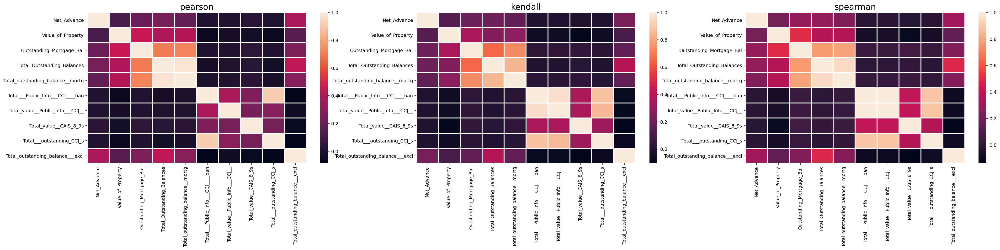

In [135]:
# plotting heatmap usill all methods for all numerical variables
plt.figure(figsize=(36,6), dpi=140)
for j,i in enumerate(['pearson','kendall','spearman']):
  plt.subplot(1,3,j+1)
  correlation = df.loc[:,customer_amount].corr(method=i)
  sns.heatmap(correlation, linewidth = 2)
  plt.title(i, fontsize=18)



In [192]:
df.loc[:,customer_amount].corr()>0.5

,Net_Advance,Value_of_Property,Outstanding_Mortgage_Bal,Total_Outstanding_Balances,Total_outstanding_balance__mortg,Total___Public_Info___CCJ____ban,Total_value__Public_Info___CCJ__,Total_value__CAIS_8_9s,Total___outstanding_CCJ_s,Total_outstanding_balance___excl
Net_Advance,True,False,False,False,False,False,False,False,False,False
Value_of_Property,False,True,False,False,False,False,False,False,False,False
Outstanding_Mortgage_Bal,False,False,True,True,True,False,False,False,False,False
Total_Outstanding_Balances,False,False,True,True,True,False,False,False,False,False
Total_outstanding_balance__mortg,False,False,True,True,True,False,False,False,False,False
Total___Public_Info___CCJ____ban,False,False,False,False,False,True,False,False,True,False
Total_value__Public_Info___CCJ__,False,False,False,False,False,False,True,False,False,False
Total_value__CAIS_8_9s,False,False,False,False,False,False,False,True,False,False
Total___outstanding_CCJ_s,False,False,False,False,False,True,False,False,True,False
Total_outstanding_balance___excl,False,False,False,False,False,False,False,False,False,True


# variables to be selected from customer_amount
1.Outstanding_Mortgage_Bal &Total_Outstanding_Balances are highly co-related
2.Outstanding_Mortgage_Bal& Total_outstanding_balance__mortg are highly co-related
3.Total_Outstanding_Balances & Total_outstanding_balance__mortg are highly co-related

considering point 1,2 and 3 we can select one variable Total_Outstanding_Balances

1.Total___Public_Info___CCJ____ban & Total___outstanding_CCJ_s are highly corelated
2.Total___outstanding_CCJ_s & Total___Public_Info___CCJ____ban are highly co-related




In [ ]:
customer_amount = ['Net_Advance','Value_of_Property','Total_Outstanding_Balances','Total___Public_Info___CCJ____ban','Total_value__CAIS_8_9s','Total_outstanding_balance___excl']

In [289]:
#Rule4 EDA for continous variable(for continous variable we can take mean aur STD for data points where PPI=1 to define threshold to target customer having PPI=0)
df.loc[(df['PPI']==1),customer_details_cont].describe()

,APR,Term,Mosaic,Time_at_Address,Time_in_Employment,Income_Range,Time_with_Bank,Age,Time_since_most_recent_Public_In,Credit_Score
count,9461.000000,9461.000000,9461.000000,9461.000000,9461.00000,9461.000000,9461.000000,9461.000000,9461.000000,9461.000000
mean,19.271610,61.741888,31.381038,129.082021,101.53673,4.404503,197.939013,44.768735,88.082867,871.023993
std,9.901766,27.251238,15.781346,113.341008,90.05896,1.492298,105.853847,10.972828,25.958169,85.057591
min,6.400000,6.000000,0.000000,1.000000,0.00000,0.000000,0.000000,19.000000,-1.000000,413.000000
25%,10.900000,48.000000,19.000000,43.000000,39.00000,3.000000,120.000000,37.000000,99.000000,812.000000
50%,17.400000,60.000000,32.000000,96.000000,72.00000,5.000000,187.000000,44.000000,99.000000,870.000000
75%,25.900000,60.000000,44.000000,192.000000,137.00000,6.000000,256.000000,52.000000,99.000000,931.000000
max,44.900000,300.000000,99.000000,809.000000,600.00000,6.000000,756.000000,74.000000,99.000000,1154.000000


In [290]:
#Rule5 EDA for continous variable(for continous variable we can take mean aur STD for data points where PPI=1 to define threshold to target customer having PPI=0)
df.loc[(df['PPI']==1),customer_amount].describe()

,Net_Advance,Value_of_Property,Total_Outstanding_Balances,Total___Public_Info___CCJ____ban,Total_value__CAIS_8_9s,Total_outstanding_balance___excl
count,9461.000000,9.461000e+03,9.461000e+03,9461.000000,9461.000000,9461.000000
mean,7339.648635,1.513776e+05,6.836611e+04,0.257901,21.540006,131.585773
std,6804.876018,9.359304e+04,7.641224e+04,0.706563,67.224206,136.804264
min,500.000000,1.000000e+01,0.000000e+00,-1.000000,-1.000000,-1.000000
25%,3000.000000,1.200000e+05,8.398000e+03,0.000000,0.000000,34.000000
50%,5000.000000,1.200000e+05,4.762500e+04,0.000000,0.000000,90.000000
75%,9000.000000,1.700000e+05,1.065590e+05,0.000000,12.000000,184.000000
max,63350.000000,2.700000e+06,1.185150e+06,9.000000,999.000000,999.000000


# Method 1: To identify customers to target based on Exploratory Data Analysis of data as shown below

we can combine above rule 1,2,3,4,5 obtained by EDA for relevant features to target customers having PPI=0

In [193]:
# Final variable after basic hypothesis selection are:

#categorical variable
customer_details_cat = ['Final_Grade','Residential_Status','Number_of_Dependants','Marital_Status','Gender','Employment_Status','Worst_status_L6m',
                        'Worst_CUrrent_Status','__of_status_3_s_L6m','Searches___Total___L6m','Total___of_accounts','Years_on_ER_for_SP','Time_since_most_recent_outstandi']

customer_product = ['PPI','PPI_SINGLE','PPI_JOINT','PPI_LCI']


customer_card=['ACCESS_Card','Diners_Card','Cheque_Guarantee','Other_Credit_Store_Card']

#continous variable
customer_details_cont = ['APR','Term','Mosaic',
                   'Time_at_Address','Time_in_Employment','Income_Range',
                   'Time_with_Bank','Age','Time_since_most_recent_Public_In','Credit_Score']

customer_amount = ['Net_Advance','Value_of_Property','Total_Outstanding_Balances','Total___Public_Info___CCJ____ban','Total_value__CAIS_8_9s','Total_outstanding_balance___excl']

In [194]:
# Total number of avriable after variable reduction

print('Total number of variable before variable reduction is {} and after variable reduction is {}'.format(len(df.columns),(len(customer_details_cat)+len(customer_product)+len(customer_card)+len(customer_details_cont)+len(customer_amount))))

Total number of variable before variable reduction is 59 and after variable reduction is 37


In [195]:
# custom function for easy and efficient analysis of numerical univariate

def UVA_numeric(data, var_group):
  '''
  Univariate_Analysis_numeric
  takes a group of variables (INTEGER and FLOAT) and plot/print all the descriptives and properties along with KDE.

  Runs a loop: calculate all the descriptives of i(th) variable and plot/print it
  '''

  size = len(var_group)
  plt.figure(figsize = (7*size,3), dpi = 100)
  
  #looping for each variable
  for j,i in enumerate(var_group):
    
    # calculating descriptives of variable
    mini = data[i].min()
    maxi = data[i].max()
    ran = data[i].max()-data[i].min()
    mean = data[i].mean()
    median = data[i].median()
    st_dev = data[i].std()
    skew = data[i].skew()
    kurt = data[i].kurtosis()

    # calculating points of standard deviation
    points = mean-st_dev, mean+st_dev

    #Plotting the variable with every information
    plt.subplot(1,size,j+1)
    sns.kdeplot(data[i], shade=True)
    sns.lineplot(points, [0,0], color = 'black', label = "std_dev")
    sns.scatterplot([mini,maxi], [0,0], color = 'orange', label = "min/max")
    sns.scatterplot([mean], [0], color = 'red', label = "mean")
    sns.scatterplot([median], [0], color = 'blue', label = "median")
    plt.xlabel('{}'.format(i), fontsize = 20)
    plt.ylabel('density')
    plt.title('std_dev = {}; kurtosis = {};\nskew = {}; range = {}\nmean = {}; median = {}'.format((round(points[0],2),round(points[1],2)),
                                                                                                   round(kurt,2),
                                                                                                   round(skew,2),
                                                                                                   (round(mini,2),round(maxi,2),round(ran,2)),
                                                                                                   round(mean,2),
                                                                                                   round(median,2)))

In [199]:
df['Term'].value_counts()

60     8428
120    1766
36     1736
48     1492
24      812
37      379
12      301
84      201
18      152
30      149
25      146
49      122
42      104
96       85
72       84
54       33
38       23
13       20
40       19
108      16
180      13
39       11
33       10
32       10
50       10
90        9
28        9
26        9
240       9
52        8
59        8
14        7
22        7
43        7
20        7
73        7
300       7
85        6
47        6
27        6
44        6
86        6
15        5
55        5
31        5
66        5
78        5
75        4
87        4
63        4
46        4
19        4
80        3
29        3
65        3
17        3
34        3
89        3
58        3
98        3
61        3
45        2
109       2
53        2
23        2
6         2
94        2
62        2
16        2
228       2
64        2
57        2
41        2
35        2
51        2
144       2
112       2
97        2
88        2
68        2
76        2
92        2
100       2
56  

In [200]:
df.head()

,Ref,Credit_Score,Final_Grade,Term,Net_Advance,APR,Loan_Type,Mosaic,Mosaic_Class,Time_at_Address,Residential_Status,Telephone_Indicator,Number_of_Dependants,Marital_Status,Gender,Time_in_Employment,Employment_Status,Full_Part_Time_Empl_Ind,Perm_Temp_Empl_Ind,Income_Range,Current_Account,ACCESS_Card,VISA_Card,American_Express,Diners_Card,Cheque_Guarantee,Other_Credit_Store_Card,Time_with_Bank,Value_of_Property,Outstanding_Mortgage_Bal,Total_Outstanding_Balances,Bureau_Data___Monthly_Other_Co_R,Worst_History_CT,Payment_Method,Age,Total_outstanding_balance__mortg,Total___Public_Info___CCJ____ban,Total_value__Public_Info___CCJ__,Time_since_most_recent_Public_In,Total_value__CAIS_8_9s,Worst_status_L6m,Worst_CUrrent_Status,__of_status_3_s_L6m,Searches___Total___L6m,Years_on_ER_for_SP,Bankruptcy_Detected__SP_,Total___outstanding_CCJ_s,Total_outstanding_balance___excl,Total___of_accounts,CIFAS_detected,Time_since_most_recent_outstandi,Insurance_Description,PPI,code,prdt_desc,category,PPI_SINGLE,PPI_JOINT,PPI_LCI
0,1,918,A,36,3000.0,14.4,UnSecured,46,8,132,H,Y,0,M,M,288,S,F,P,6,TRUE,FALSE,FALSE,FALSE,FALSE,TRUE,TRUE,168,178000,47679,64406,513,5,D,46,64,1,5,16,0,0,0,0,9,10,N,1,18,6,N,16,NaN,0,NaN,NaN,NaN,0,0,0
1,3,903,A,120,21000.0,7.9,secured,16,3,288,H,Y,0,S,F,37,R,P,P,2,TRUE,FALSE,TRUE,FALSE,FALSE,TRUE,FALSE,300,180000,11563,31614,331,5,D,59,13,0,0,99,0,1,0,0,6,22,N,0,203,8,N,99,Life & Critical Illn,1,748.0,LIFE & CRITICAL ILLNESS,LCI,0,0,1
2,4,1060,X,78,7200.0,7.9,secured,17,3,276,H,Y,0,M,M,154,P,F,P,5,TRUE,FALSE,TRUE,FALSE,FALSE,TRUE,FALSE,369,199000,17563,26045,413,0,D,56,19,2,30,50,266,0,0,0,1,21,N,1,87,7,N,50,Joint,1,719.0,LASCI JOINT,Joint,0,1,0
3,6,839,B,60,8000.0,16.9,UnSecured,47,8,48,R,Y,0,M,M,82,G,F,P,6,TRUE,FALSE,TRUE,FALSE,FALSE,TRUE,FALSE,216,120000,0,181217,1112,5,D,33,160,0,0,99,1,1,0,0,5,0,N,0,229,9,N,99,Life & Critical Illn,1,748.0,LIFE & CRITICAL ILLNESS,LCI,0,0,1
4,7,1057,X,60,7650.0,7.4,UnSecured,55,10,156,H,Y,2,M,M,342,S,F,P,6,TRUE,TRUE,FALSE,FALSE,FALSE,TRUE,FALSE,510,180000,60101,63811,435,0,D,49,62,0,0,99,0,0,0,0,1,13,N,0,38,6,N,99,Single,1,718.0,LASCI,Single,1,0,0


/Users/3482520/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/3482520/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/3482520/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretatio

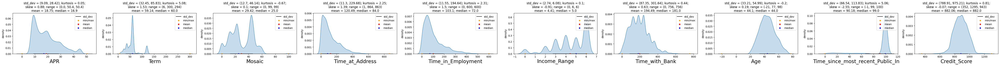

In [202]:
UVA_numeric(df,customer_details_cont)

/Users/3482520/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/3482520/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/3482520/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretatio

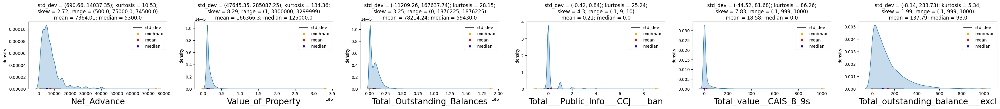

In [201]:
UVA_numeric(df,customer_amount)

by doing univariate analysis for continous variable we can summarize that Time_at_address and Time in employment has same distribution and statistical distribution so we can consider any one of the field in final variable selection and also we can see 
that there are few outliers in all amount fields so we can take care of outlier before making any final decision

In [ ]:
#final variable after all EDA:

# Final variable after basic hypothesis selection are:

#continous variable
customer_details_cat = ['Final_Grade','Residential_Status','Number_of_Dependants','Marital_Status','Gender','Employment_Status','Worst_status_L6m',
                        'Worst_CUrrent_Status','__of_status_3_s_L6m','Searches___Total___L6m','Total___of_accounts','Time_since_most_recent_outstandi']

customer_product = ['PPI','PPI_SINGLE','PPI_JOINT','PPI_LCI']


customer_card=['ACCESS_Card','Diners_Card','Cheque_Guarantee','Other_Credit_Store_Card']

#categorical variable
customer_details_cont = ['APR','Term','Mosaic',
                   'Time_at_Address','Time_in_Employment','Income_Range',
                   'Time_with_Bank','Age','Time_since_most_recent_Public_In','Credit_Score']

customer_amount = ['Net_Advance','Value_of_Property','Total_Outstanding_Balances','Total___Public_Info___CCJ____ban','Total_value__CAIS_8_9s','Total_outstanding_balance___excl']

In [205]:
#Create final dataframe for targeting from the pool of customers that currently do not have a PPI:
final_col=customer_details_cat+customer_product+customer_card+customer_details_cont+customer_amount
df_cust=df.loc[:,final_col]

In [220]:
df_cust.head()

,Final_Grade,Residential_Status,Number_of_Dependants,Marital_Status,Gender,Employment_Status,Worst_status_L6m,Worst_CUrrent_Status,__of_status_3_s_L6m,Searches___Total___L6m,Total___of_accounts,Years_on_ER_for_SP,Time_since_most_recent_outstandi,PPI,PPI_SINGLE,PPI_JOINT,PPI_LCI,ACCESS_Card,Diners_Card,Cheque_Guarantee,Other_Credit_Store_Card,APR,Term,Mosaic,Time_at_Address,Time_in_Employment,Income_Range,Time_with_Bank,Age,Time_since_most_recent_Public_In,Credit_Score,Net_Advance,Value_of_Property,Total_Outstanding_Balances,Total___Public_Info___CCJ____ban,Total_value__CAIS_8_9s,Total_outstanding_balance___excl
0,A,H,0,M,M,S,0,0,0,9,6,10,16,0,0,0,0,FALSE,FALSE,TRUE,TRUE,14.4,36,46,132,288,6,168,46,16,918,3000.0,178000,64406,1,0,18
1,A,H,0,S,F,R,1,0,0,6,8,22,99,1,0,0,1,FALSE,FALSE,TRUE,FALSE,7.9,120,16,288,37,2,300,59,99,903,21000.0,180000,31614,0,0,203
2,X,H,0,M,M,P,0,0,0,1,7,21,50,1,0,1,0,FALSE,FALSE,TRUE,FALSE,7.9,78,17,276,154,5,369,56,50,1060,7200.0,199000,26045,2,266,87
3,B,R,0,M,M,G,1,0,0,5,9,0,99,1,0,0,1,FALSE,FALSE,TRUE,FALSE,16.9,60,47,48,82,6,216,33,99,839,8000.0,120000,181217,0,1,229
4,X,H,2,M,M,S,0,0,0,1,6,13,99,1,1,0,0,TRUE,FALSE,TRUE,FALSE,7.4,60,55,156,342,6,510,49,99,1057,7650.0,180000,63811,0,0,38


In [212]:
#Encoding categorical variables to define any model to
df_cust.dtypes[df_cust.dtypes == 'object'].index

Index(['Final_Grade', 'Residential_Status', 'Marital_Status', 'Gender',
       'Employment_Status', 'ACCESS_Card', 'Diners_Card', 'Cheque_Guarantee',
       'Other_Credit_Store_Card'],
      dtype='object')

In [221]:
from sklearn.preprocessing import LabelEncoder
le=LabelEncoder()
df_cust=df_cust.apply(LabelEncoder().fit_transform)

In [222]:
df_cust.head()

,Final_Grade,Residential_Status,Number_of_Dependants,Marital_Status,Gender,Employment_Status,Worst_status_L6m,Worst_CUrrent_Status,__of_status_3_s_L6m,Searches___Total___L6m,Total___of_accounts,Years_on_ER_for_SP,Time_since_most_recent_outstandi,PPI,PPI_SINGLE,PPI_JOINT,PPI_LCI,ACCESS_Card,Diners_Card,Cheque_Guarantee,Other_Credit_Store_Card,APR,Term,Mosaic,Time_at_Address,Time_in_Employment,Income_Range,Time_with_Bank,Age,Time_since_most_recent_Public_In,Credit_Score,Net_Advance,Value_of_Property,Total_Outstanding_Balances,Total___Public_Info___CCJ____ban,Total_value__CAIS_8_9s,Total_outstanding_balance___excl
0,0,0,0,1,1,6,0,0,1,9,7,11,16,0,0,0,0,0,0,1,1,73,27,46,131,288,6,167,30,16,359,210,275,7096,2,1,19
1,0,0,0,2,0,5,1,0,1,6,9,23,73,1,0,0,1,0,0,1,0,9,94,16,287,37,2,299,43,73,344,1066,279,5391,1,1,204
2,9,0,0,1,1,4,0,0,1,1,8,22,50,1,0,1,0,0,0,1,0,9,66,17,275,154,5,368,40,50,498,706,309,5015,3,250,88
3,1,2,0,1,1,1,1,0,1,5,10,1,73,1,0,0,1,0,0,1,0,97,51,47,47,82,6,215,17,73,280,776,168,13194,1,2,230
4,9,0,2,1,1,6,0,0,1,1,7,14,73,1,1,0,0,1,0,1,0,4,51,55,155,342,6,486,33,73,495,746,279,7054,1,1,39


In [224]:
df_train=df_cust.loc[(df_cust['PPI']==1)]
df_test=df_cust.loc[(df_cust['PPI']==0)]

In [225]:
len(df_train)

9461

In [226]:
len(df_test)

6922

In [227]:
df_train.head()

,Final_Grade,Residential_Status,Number_of_Dependants,Marital_Status,Gender,Employment_Status,Worst_status_L6m,Worst_CUrrent_Status,__of_status_3_s_L6m,Searches___Total___L6m,Total___of_accounts,Years_on_ER_for_SP,Time_since_most_recent_outstandi,PPI,PPI_SINGLE,PPI_JOINT,PPI_LCI,ACCESS_Card,Diners_Card,Cheque_Guarantee,Other_Credit_Store_Card,APR,Term,Mosaic,Time_at_Address,Time_in_Employment,Income_Range,Time_with_Bank,Age,Time_since_most_recent_Public_In,Credit_Score,Net_Advance,Value_of_Property,Total_Outstanding_Balances,Total___Public_Info___CCJ____ban,Total_value__CAIS_8_9s,Total_outstanding_balance___excl
1,0,0,0,2,0,5,1,0,1,6,9,23,73,1,0,0,1,0,0,1,0,9,94,16,287,37,2,299,43,73,344,1066,279,5391,1,1,204
2,9,0,0,1,1,4,0,0,1,1,8,22,50,1,0,1,0,0,0,1,0,9,66,17,275,154,5,368,40,50,498,706,309,5015,3,250,88
3,1,2,0,1,1,1,1,0,1,5,10,1,73,1,0,0,1,0,0,1,0,97,51,47,47,82,6,215,17,73,280,776,168,13194,1,2,230
4,9,0,2,1,1,6,0,0,1,1,7,14,73,1,1,0,0,1,0,1,0,4,51,55,155,342,6,486,33,73,495,746,279,7054,1,1,39
5,0,0,0,1,1,4,0,0,1,1,10,2,73,1,1,0,0,0,0,1,0,24,94,59,17,170,6,239,29,73,354,1130,319,13866,1,1,525


# Method 2: To identify customers to target based on statistical bhevaiour of data as shown below
By seeing the statistical summary of different features we can define different rules by cosnidering mean,std as threshold parameter to identify customers for cross sell PPI


In [228]:
df_train.describe()

,Final_Grade,Residential_Status,Number_of_Dependants,Marital_Status,Gender,Employment_Status,Worst_status_L6m,Worst_CUrrent_Status,__of_status_3_s_L6m,Searches___Total___L6m,Total___of_accounts,Years_on_ER_for_SP,Time_since_most_recent_outstandi,PPI,PPI_SINGLE,PPI_JOINT,PPI_LCI,ACCESS_Card,Diners_Card,Cheque_Guarantee,Other_Credit_Store_Card,APR,Term,Mosaic,Time_at_Address,Time_in_Employment,Income_Range,Time_with_Bank,Age,Time_since_most_recent_Public_In,Credit_Score,Net_Advance,Value_of_Property,Total_Outstanding_Balances,Total___Public_Info___CCJ____ban,Total_value__CAIS_8_9s,Total_outstanding_balance___excl
count,9461.000000,9461.000000,9461.000000,9461.000000,9461.000000,9461.000000,9461.000000,9461.000000,9461.000000,9461.000000,9461.000000,9461.000000,9461.000000,9461.0,9461.000000,9461.000000,9461.000000,9461.000000,9461.000000,9461.000000,9461.000000,9461.000000,9461.000000,9461.000000,9461.000000,9461.000000,9461.000000,9461.000000,9461.000000,9461.000000,9461.000000,9461.000000,9461.000000,9461.000000,9461.000000,9461.000000,9461.000000
mean,3.372794,0.705211,0.762182,1.263820,0.587570,3.628052,0.874960,0.546665,1.380192,2.945143,6.787549,8.035091,67.352394,1.0,0.662086,0.129479,0.208435,0.192686,0.013001,0.906564,0.218370,110.779833,50.218899,31.298911,127.238981,101.269845,4.404503,196.326815,28.768735,66.375859,312.138992,533.612515,213.116690,6474.050946,1.257689,20.554910,131.543706
std,3.412608,1.222794,1.089199,0.672434,0.492298,1.537691,1.361936,1.214981,1.341777,2.373625,2.624470,7.748002,16.198893,0.0,0.473024,0.335747,0.406211,0.394429,0.113283,0.291058,0.413162,83.221449,21.614887,15.523380,110.330996,88.960843,1.492298,103.832758,10.972828,17.115623,84.177473,341.567472,100.644854,4236.847498,0.704092,50.145624,131.915349
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000,0.000000,4.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,1.000000,0.000000,4.000000,0.000000,0.000000,1.000000,1.000000,5.000000,2.000000,73.000000,1.0,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,39.000000,39.000000,19.000000,42.000000,39.000000,3.000000,119.000000,21.000000,73.000000,253.000000,210.000000,168.000000,2713.000000,1.000000,1.000000,35.000000
50%,2.000000,0.000000,0.000000,1.000000,1.000000,4.000000,0.000000,0.000000,1.000000,2.000000,7.000000,5.000000,73.000000,1.0,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,101.000000,51.000000,32.000000,95.000000,72.000000,5.000000,186.000000,28.000000,73.000000,311.000000,453.000000,168.000000,6213.000000,1.000000,1.000000,91.000000
75%,6.000000,1.000000,1.000000,2.000000,1.000000,4.000000,1.000000,1.000000,1.000000,4.000000,10.000000,12.000000,73.000000,1.0,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,168.000000,51.000000,44.000000,191.000000,137.000000,6.000000,255.000000,36.000000,73.000000,372.000000,859.000000,262.000000,9979.000000,1.000000,13.000000,185.000000
max,9.000000,3.000000,8.000000,3.000000,1.000000,8.000000,6.000000,6.000000,10.000000,9.000000,10.000000,35.000000,73.000000,1.0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,309.000000,102.000000,62.000000,523.000000,468.000000,6.000000,533.000000,58.000000,73.000000,556.000000,1168.000000,652.000000,14739.000000,9.000000,386.000000,748.000000


# Method 3: using distance based clusering algorithm we can create 2 clusters and identify cluster where most of the data points with PPI=1 lies and then check for the data points which belongs with this cluster having PPI=0 and send select customer accordingly

In [242]:
%matplotlib inline 
from sklearn.cluster import KMeans

In [239]:
data=df_cust.drop(['PPI'], axis = 1)

In [240]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

data_scaled = scaler.fit_transform(data)

In [243]:
kmeans = KMeans(n_clusters=2)

In [244]:
kmeans.fit(data)

KMeans(n_clusters=2)

In [245]:
pred=kmeans.predict(data)

In [246]:
df_cust['cluster']=pred

In [247]:
df_cust['cluster'].value_counts()

0    8363
1    8020
Name: cluster, dtype: int64

In [248]:
df_cust.loc[(df_cust['PPI']==1),'cluster'].value_counts()

0    5204
1    4257
Name: cluster, dtype: int64

In [ ]:
#by seeing the above distribution we can say that customer who has bought PPI maximum belongs to cluster=0 so we can target customers with cluster=0 and PPI=0 to sell PPI plan
#Above distribution is not accurate ofcourse we can fine tune the models by tuning model parameters to bring maximum point in clsuter=0 where PPI=1 

In [249]:
df_cust.loc[(df_cust['PPI']==0),'cluster'].value_counts()

1    3763
0    3159
Name: cluster, dtype: int64

# Method 4: Using autoencoder by training model where PPI=1 and calculate reconstruction error to define threshold of recontruction error for PPI=0 
 Target customer for PPI=0 with recontruction error close to customer with PPI=1 Which can be considered as similar customers

In [250]:
df_cust.head()

,Final_Grade,Residential_Status,Number_of_Dependants,Marital_Status,Gender,Employment_Status,Worst_status_L6m,Worst_CUrrent_Status,__of_status_3_s_L6m,Searches___Total___L6m,Total___of_accounts,Years_on_ER_for_SP,Time_since_most_recent_outstandi,PPI,PPI_SINGLE,PPI_JOINT,PPI_LCI,ACCESS_Card,Diners_Card,Cheque_Guarantee,Other_Credit_Store_Card,APR,Term,Mosaic,Time_at_Address,Time_in_Employment,Income_Range,Time_with_Bank,Age,Time_since_most_recent_Public_In,Credit_Score,Net_Advance,Value_of_Property,Total_Outstanding_Balances,Total___Public_Info___CCJ____ban,Total_value__CAIS_8_9s,Total_outstanding_balance___excl,cluster
0,0,0,0,1,1,6,0,0,1,9,7,11,16,0,0,0,0,0,0,1,1,73,27,46,131,288,6,167,30,16,359,210,275,7096,2,1,19,1
1,0,0,0,2,0,5,1,0,1,6,9,23,73,1,0,0,1,0,0,1,0,9,94,16,287,37,2,299,43,73,344,1066,279,5391,1,1,204,0
2,9,0,0,1,1,4,0,0,1,1,8,22,50,1,0,1,0,0,0,1,0,9,66,17,275,154,5,368,40,50,498,706,309,5015,3,250,88,0
3,1,2,0,1,1,1,1,0,1,5,10,1,73,1,0,0,1,0,0,1,0,97,51,47,47,82,6,215,17,73,280,776,168,13194,1,2,230,1
4,9,0,2,1,1,6,0,0,1,1,7,14,73,1,1,0,0,1,0,1,0,4,51,55,155,342,6,486,33,73,495,746,279,7054,1,1,39,1


In [252]:
dataset_train=df_cust.loc[(df_cust['PPI']==1)]
dataset_train=dataset_train.drop(['PPI','cluster'], axis = 1)
dataset_test=df_cust.loc[(df_cust['PPI']==0)]
dataset_test=dataset_test.drop(['PPI','cluster'], axis = 1)
print(len(dataset_train),len(dataset_test))

9461 6922


In [255]:
len(dataset_train.columns)

36

In [257]:
# Normalize data:
# Random shuffle training data
from sklearn import preprocessing
scaler = preprocessing.MinMaxScaler()

X_train = pd.DataFrame(
    scaler.fit_transform(dataset_train),
    columns=dataset_train.columns,
    index=dataset_train.index,
)
X_train1 = X_train.copy()

# Random shuffle testing data
X_train.sample(frac=1)
X_test = pd.DataFrame(
    scaler.transform(dataset_test),
    columns=dataset_test.columns,
    index=dataset_test.index,
)
X_test1 = X_test.copy()

X_train = np.array(X_train).reshape(-1, 36)
X_test = np.array(X_test).reshape(-1, 36)

In [258]:
# splitting of data in to train and validation set to see how model performs on unknown dataset
# split data into training and validation
split_size = int(X_train.shape[0] * 0.7)

train_x, val_x = X_train[:split_size], X_train[split_size:]

In [260]:
import os
from sklearn import preprocessing
from numpy.random import seed
from keras.layers import Input, Dropout
from keras.layers.core import Dense
from keras.models import Model, Sequential, load_model
from keras import regularizers
from keras.models import model_from_json
import tensorflow

tensorflow.random.set_seed(10)
import random

random.seed(10)
from sklearn.metrics import fbeta_score, precision_score, recall_score, confusion_matrix

In [261]:
# define architecture of autoencoder

## this is our input placeholder
input_img = Input(shape=(36,))

## "encoded" is the encoded representation of the input
encoded = Dense(200, activation="relu")(input_img)
encoded = Dense(100, activation="relu")(encoded)
encoded = Dense(50, activation="relu")(encoded)
encoded = Dense(36, activation="linear")(encoded)

## "decoded" is the lossy reconstruction of the input
decoded = Dense(100, activation="relu")(encoded)
decoded = Dense(50, activation="relu")(decoded)
decoded = Dense(36, activation="linear")(decoded)

## this model maps an input to its reconstruction
autoencoder = Model(input_img, decoded)

## this model maps an input to its features
encoder = Model(input_img, encoded)

In [262]:
# print summary of autoencoder
autoencoder.summary()

Model: "functional_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 36)]              0         
_________________________________________________________________
dense (Dense)                (None, 200)               7400      
_________________________________________________________________
dense_1 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_2 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_3 (Dense)              (None, 36)                1836      
_________________________________________________________________
dense_4 (Dense)              (None, 100)               3700      
_________________________________________________________________
dense_5 (Dense)              (None, 50)               

In [263]:
# print summary of encoder
encoder.summary()

Model: "functional_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 36)]              0         
_________________________________________________________________
dense (Dense)                (None, 200)               7400      
_________________________________________________________________
dense_1 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_2 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_3 (Dense)              (None, 36)                1836      
Total params: 34,386
Trainable params: 34,386
Non-trainable params: 0
_________________________________________________________________


In [264]:
# compile autoencoder
autoencoder.compile(optimizer="adam", loss="mse")

In [265]:
from keras.models import *
from keras.layers import *
from keras.callbacks import *

mc = ModelCheckpoint(
    "best_model.hdf5", monitor="val_loss", verbose=1, save_best_only=True, mode="min"
)

In [266]:
# train autoencoder
train_history = autoencoder.fit(
    train_x, train_x, epochs=1000, validation_data=(val_x, val_x), callbacks=[mc]
)

Epoch 1/1000
183/207 [=========================>....] - ETA: 0s - loss: 0.0616
Epoch 00001: val_loss improved from inf to 0.02194, saving model to best_model.hdf5
207/207 [==============================] - 13s 63ms/step - loss: 0.0572 - val_loss: 0.0219
Epoch 2/1000
167/207 [=======================>......] - ETA: 0s - loss: 0.0155
Epoch 00002: val_loss improved from 0.02194 to 0.01112, saving model to best_model.hdf5
207/207 [==============================] - 0s 1ms/step - loss: 0.0148 - val_loss: 0.0111
Epoch 3/1000
188/207 [==========================>...] - ETA: 0s - loss: 0.0091
Epoch 00003: val_loss improved from 0.01112 to 0.00783, saving model to best_model.hdf5
207/207 [==============================] - 0s 1ms/step - loss: 0.0090 - val_loss: 0.0078
Epoch 4/1000
185/207 [=========================>....] - ETA: 0s - loss: 0.0072
Epoch 00004: val_loss improved from 0.00783 to 0.00689, saving model to best_model.hdf5
207/207 [==============================] - 0s 1ms/step - loss: 0.00

In [267]:
# Load the weights of best model prior to predictions
autoencoder.load_weights("best_model.hdf5")

In [270]:
# Prediction on train data


# calculating Threshold for Anomaly Flag
X_pred = autoencoder.predict(X_train)
X_pred = pd.DataFrame(X_pred, columns=dataset_train.columns)
X_pred.index = dataset_train.index

scored = pd.DataFrame(index=dataset_train.index)
scored["loss_mae"] = np.mean(np.abs(X_pred - X_train), axis=1)

# In[9]:

/Users/3482520/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


(0.0, 0.5)

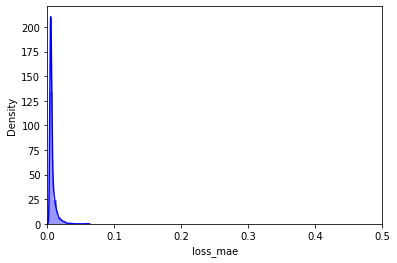

In [271]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure()
sns.distplot(scored["loss_mae"], bins=10, kde=True, color="blue")
plt.xlim([0.0, 0.5])

In [279]:
scored["loss_mae"].max()

0.061037090585735684

In [272]:
# Prediction on test data


# calculating Threshold for Anomaly Flag
X_pred_test = autoencoder.predict(X_test)
X_pred_test = pd.DataFrame(X_pred_test, columns=dataset_test.columns)
X_pred_test.index = dataset_test.index

scored_test = pd.DataFrame(index=dataset_test.index)
scored_test["loss_mae"] = np.mean(np.abs(X_pred_test - X_test), axis=1)

# In[9]:

/Users/3482520/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


(0.0, 0.5)

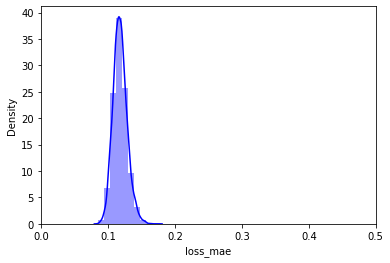

In [273]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure()
sns.distplot(scored_test["loss_mae"], bins=10, kde=True, color="blue")
plt.xlim([0.0, 0.5])

In [276]:
dataset_test.head()

,Final_Grade,Residential_Status,Number_of_Dependants,Marital_Status,Gender,Employment_Status,Worst_status_L6m,Worst_CUrrent_Status,__of_status_3_s_L6m,Searches___Total___L6m,Total___of_accounts,Years_on_ER_for_SP,Time_since_most_recent_outstandi,PPI_SINGLE,PPI_JOINT,PPI_LCI,ACCESS_Card,Diners_Card,Cheque_Guarantee,Other_Credit_Store_Card,APR,Term,Mosaic,Time_at_Address,Time_in_Employment,Income_Range,Time_with_Bank,Age,Time_since_most_recent_Public_In,Credit_Score,Net_Advance,Value_of_Property,Total_Outstanding_Balances,Total___Public_Info___CCJ____ban,Total_value__CAIS_8_9s,Total_outstanding_balance___excl
0,0,0,0,1,1,6,0,0,1,9,7,11,16,0,0,0,0,0,1,1,73,27,46,131,288,6,167,30,16,359,210,275,7096,2,1,19
7,9,0,2,1,1,4,0,0,1,6,9,9,7,0,0,0,0,0,1,1,48,51,43,162,351,6,242,33,7,402,492,118,8467,5,176,114
10,1,0,2,1,1,4,0,0,1,4,8,4,73,0,0,0,0,0,1,0,53,94,24,36,58,6,260,11,73,281,903,151,10134,1,28,121
14,0,0,0,0,1,4,0,0,1,3,10,21,73,0,0,0,0,0,1,0,24,28,15,3,240,5,299,32,73,337,453,372,14204,1,1,17
23,9,0,3,0,0,4,0,0,1,0,7,14,73,0,0,0,1,0,1,0,9,39,24,155,81,3,167,18,73,407,776,103,5832,1,1,14


In [274]:
scored_test.head()

,loss_mae
0,0.138611
7,0.153191
10,0.107075
14,0.113713
23,0.130588


In [277]:
dataset_test['loss_mae']=scored_test

In [278]:
dataset_test.head()

,Final_Grade,Residential_Status,Number_of_Dependants,Marital_Status,Gender,Employment_Status,Worst_status_L6m,Worst_CUrrent_Status,__of_status_3_s_L6m,Searches___Total___L6m,Total___of_accounts,Years_on_ER_for_SP,Time_since_most_recent_outstandi,PPI_SINGLE,PPI_JOINT,PPI_LCI,ACCESS_Card,Diners_Card,Cheque_Guarantee,Other_Credit_Store_Card,APR,Term,Mosaic,Time_at_Address,Time_in_Employment,Income_Range,Time_with_Bank,Age,Time_since_most_recent_Public_In,Credit_Score,Net_Advance,Value_of_Property,Total_Outstanding_Balances,Total___Public_Info___CCJ____ban,Total_value__CAIS_8_9s,Total_outstanding_balance___excl,loss_mae
0,0,0,0,1,1,6,0,0,1,9,7,11,16,0,0,0,0,0,1,1,73,27,46,131,288,6,167,30,16,359,210,275,7096,2,1,19,0.138611
7,9,0,2,1,1,4,0,0,1,6,9,9,7,0,0,0,0,0,1,1,48,51,43,162,351,6,242,33,7,402,492,118,8467,5,176,114,0.153191
10,1,0,2,1,1,4,0,0,1,4,8,4,73,0,0,0,0,0,1,0,53,94,24,36,58,6,260,11,73,281,903,151,10134,1,28,121,0.107075
14,0,0,0,0,1,4,0,0,1,3,10,21,73,0,0,0,0,0,1,0,24,28,15,3,240,5,299,32,73,337,453,372,14204,1,1,17,0.113713
23,9,0,3,0,0,4,0,0,1,0,7,14,73,0,0,0,1,0,1,0,9,39,24,155,81,3,167,18,73,407,776,103,5832,1,1,14,0.130588


In [284]:
len(dataset_test.loc[(dataset_test['loss_mae']<0.1)])

214

# Conclusion
1.we can consider these point as similar to training data point as there recontruction error is close to training data recontruction error

2.Above model performance is not good we can further fine tune the model by reducing the variables using PCA and adding different input and hidden layer to bring reconstruction error close to training data recontruction error


# Problem statement 2: What type of PPI product they should be targeting them with..

In [ ]:
we can use here recommendation techniuqe and filtering method to recommend product

In [292]:
df.head()

,Ref,Credit_Score,Final_Grade,Term,Net_Advance,APR,Loan_Type,Mosaic,Mosaic_Class,Time_at_Address,Residential_Status,Telephone_Indicator,Number_of_Dependants,Marital_Status,Gender,Time_in_Employment,Employment_Status,Full_Part_Time_Empl_Ind,Perm_Temp_Empl_Ind,Income_Range,Current_Account,ACCESS_Card,VISA_Card,American_Express,Diners_Card,Cheque_Guarantee,Other_Credit_Store_Card,Time_with_Bank,Value_of_Property,Outstanding_Mortgage_Bal,Total_Outstanding_Balances,Bureau_Data___Monthly_Other_Co_R,Worst_History_CT,Payment_Method,Age,Total_outstanding_balance__mortg,Total___Public_Info___CCJ____ban,Total_value__Public_Info___CCJ__,Time_since_most_recent_Public_In,Total_value__CAIS_8_9s,Worst_status_L6m,Worst_CUrrent_Status,__of_status_3_s_L6m,Searches___Total___L6m,Years_on_ER_for_SP,Bankruptcy_Detected__SP_,Total___outstanding_CCJ_s,Total_outstanding_balance___excl,Total___of_accounts,CIFAS_detected,Time_since_most_recent_outstandi,Insurance_Description,PPI,code,prdt_desc,category,PPI_SINGLE,PPI_JOINT,PPI_LCI
0,1,918,A,36,3000.0,14.4,UnSecured,46,8,132,H,Y,0,M,M,288,S,F,P,6,TRUE,FALSE,FALSE,FALSE,FALSE,TRUE,TRUE,168,178000,47679,64406,513,5,D,46,64,1,5,16,0,0,0,0,9,10,N,1,18,6,N,16,NaN,0,NaN,NaN,NaN,0,0,0
1,3,903,A,120,21000.0,7.9,secured,16,3,288,H,Y,0,S,F,37,R,P,P,2,TRUE,FALSE,TRUE,FALSE,FALSE,TRUE,FALSE,300,180000,11563,31614,331,5,D,59,13,0,0,99,0,1,0,0,6,22,N,0,203,8,N,99,Life & Critical Illn,1,748.0,LIFE & CRITICAL ILLNESS,LCI,0,0,1
2,4,1060,X,78,7200.0,7.9,secured,17,3,276,H,Y,0,M,M,154,P,F,P,5,TRUE,FALSE,TRUE,FALSE,FALSE,TRUE,FALSE,369,199000,17563,26045,413,0,D,56,19,2,30,50,266,0,0,0,1,21,N,1,87,7,N,50,Joint,1,719.0,LASCI JOINT,Joint,0,1,0
3,6,839,B,60,8000.0,16.9,UnSecured,47,8,48,R,Y,0,M,M,82,G,F,P,6,TRUE,FALSE,TRUE,FALSE,FALSE,TRUE,FALSE,216,120000,0,181217,1112,5,D,33,160,0,0,99,1,1,0,0,5,0,N,0,229,9,N,99,Life & Critical Illn,1,748.0,LIFE & CRITICAL ILLNESS,LCI,0,0,1
4,7,1057,X,60,7650.0,7.4,UnSecured,55,10,156,H,Y,2,M,M,342,S,F,P,6,TRUE,TRUE,FALSE,FALSE,FALSE,TRUE,FALSE,510,180000,60101,63811,435,0,D,49,62,0,0,99,0,0,0,0,1,13,N,0,38,6,N,99,Single,1,718.0,LASCI,Single,1,0,0


In [295]:
df['Ref'].value_counts().head()

32768    1
40714    1
7369     1
1226     1
23761    1
Name: Ref, dtype: int64

In [324]:
df_prod=df.loc[(df['PPI']==1),['Ref','prdt_desc','category','Insurance_Description','code']]

In [297]:
df_prod.isnull().sum()

prdt_desc                116
category                   0
Insurance_Description      0
code                      56
dtype: int64

In [302]:
#Drop the records with missing values as they are few in number
df_prod=df_prod.dropna()

In [303]:
len(df_prod)

9345

In [304]:
df_prod.head()

,prdt_desc,category,Insurance_Description,code
1,LIFE & CRITICAL ILLNESS,LCI,Life & Critical Illn,748.0
2,LASCI JOINT,Joint,Joint,719.0
3,LIFE & CRITICAL ILLNESS,LCI,Life & Critical Illn,748.0
4,LASCI,Single,Single,718.0
5,LASU,Single,Single,715.0


# solution1: Identifying top products based on number of subscription to be used for targeting PPI product

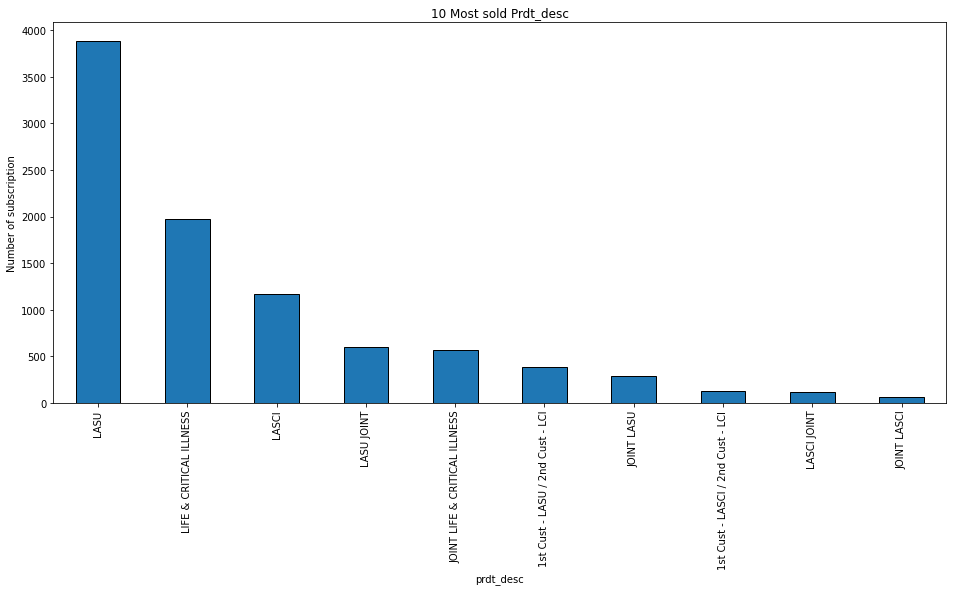

In [325]:
fig, ax=plt.subplots(figsize=(16,7))
df_prod['prdt_desc'].value_counts().sort_values(ascending=False).head(10).plot.bar(width=0.5,edgecolor='k',align='center',linewidth=1)
plt.xlabel('prdt_desc')
plt.ylabel('Number of subscription')
plt.title('10 Most sold Prdt_desc')
plt.show()

solution 1.Most frequently bought products are :LASU,LIFE & CRITICAL ILLNESS,LASCI,LASCI JOINT,JOINT LIFE & CRITICAL ILLNES

# solution2:using mining association rules using mlxtend to get top product

In [329]:
#Importing required modules from mlxtend
from mlxtend.frequent_patterns import apriori
from mlxtend.frequent_patterns import association_rules

In [326]:
df.groupby(['Ref', 'prdt_desc'])['prdt_desc'].count().unstack().fillna(0)

prdt_desc,1st Cust - LASCI / 2nd Cust - LASU,1st Cust - LASCI / 2nd Cust - LCI,1st Cust - LASU / 2nd Cust - L,1st Cust - LASU / 2nd Cust - LASCI,1st Cust - LASU / 2nd Cust - LCI,1st Cust LASCI / 2nd Cust LASU,1st Cust LASU / 2nd Cust LASCI,JOINT LASCI,JOINT LASU,JOINT LIFE & CRITICAL ILLNESS,LASCI,LASCI JOINT,LASU,LASU JOINT,LIFE & CRITICAL ILLNESS
Ref,,,,,,,,,,,,,,,
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
7,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
8,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
13,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
20,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In order to use apriori algorithm and find out the relevant association rules, we need to convert the transactions into user item matrix such that each column is an item and each value in the matrix is 1 if an item belongs to a transaction and 0 if an item does not belong to a transaction

## 1. Preprocessing Dataset for mining association rules using mlxtend <a class="anchor" id="preprocess"></a>
For applying apriori algorithm from mlxtend library, we need to first convert this into a format where all the items are as columns and filled with 1 if an item is in the transaction and 0 otherwise

In [331]:
#Finally you can store the result separately
hot_encoded_df = df.groupby(['Ref', 'prdt_desc'])['prdt_desc'].count().unstack().fillna(0)
hot_encoded_df

prdt_desc,1st Cust - LASCI / 2nd Cust - LASU,1st Cust - LASCI / 2nd Cust - LCI,1st Cust - LASU / 2nd Cust - L,1st Cust - LASU / 2nd Cust - LASCI,1st Cust - LASU / 2nd Cust - LCI,1st Cust LASCI / 2nd Cust LASU,1st Cust LASU / 2nd Cust LASCI,JOINT LASCI,JOINT LASU,JOINT LIFE & CRITICAL ILLNESS,LASCI,LASCI JOINT,LASU,LASU JOINT,LIFE & CRITICAL ILLNESS
Ref,,,,,,,,,,,,,,,
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
7,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
8,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
13,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
20,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [327]:
#First step is to group it by transaction id and item to find item count in each transaction
df.groupby(['Ref', 'prdt_desc'])['prdt_desc'].count()

Ref    prdt_desc                         
3      LIFE & CRITICAL ILLNESS               1
4      LASCI JOINT                           1
6      LIFE & CRITICAL ILLNESS               1
7      LASCI                                 1
8      LASU                                  1
9      LASCI                                 1
11     LASCI                                 1
13     LIFE & CRITICAL ILLNESS               1
20     LIFE & CRITICAL ILLNESS               1
21     LASU                                  1
23     LIFE & CRITICAL ILLNESS               1
25     LASCI                                 1
27     LASU JOINT                            1
30     JOINT LIFE & CRITICAL ILLNESS         1
31     LASU                                  1
32     LASU JOINT                            1
38     LASCI JOINT                           1
41     JOINT LIFE & CRITICAL ILLNESS         1
43     LASU JOINT                            1
47     1st Cust - LASU / 2nd Cust - LCI      1
51     1st Cust - 

In [332]:
#Function to change all the values greater than or equal to 1 as just 1 and others to be 0
def encode_units(x):
    if x <= 0:
        return 0
    if x >= 1:
        return 1

#Applying the function to the encoded dataframe
hot_encoded_df = hot_encoded_df.applymap(encode_units)

## 2. Finding Frequent Itemsets with given support threshold <a class="anchor" id="apriori"></a>

We will use Apriori Algorithm to find the rules with a support threshold of 0.01 or 1%. 

In [342]:
# using the 'apriori algorithm' with min_support=0.01 (1% of 9465)
# It means the item should be present in atleast 94 transaction out of 9465 transactions only when we considered that item in
# frequent itemset

frequent_itemsets = apriori(hot_encoded_df, min_support = 0.01, use_colnames = True)
frequent_itemsets.sort_values(by='support',ascending=False)

,support,itemsets
6,0.416158,(LASU)
8,0.211022,(LIFE & CRITICAL ILLNESS)
4,0.125201,(LASCI)
7,0.064633,(LASU JOINT)
3,0.061102,(JOINT LIFE & CRITICAL ILLNESS)
1,0.041413,(1st Cust - LASU / 2nd Cust - LCI)
2,0.030498,(JOINT LASU)
0,0.013804,(1st Cust - LASCI / 2nd Cust - LCI)
5,0.013162,(LASCI JOINT)


In [ ]:
# Solution 3: using different demographic features combination like age salary range marital status to identify top selling products let's see few examples and rest assumptions will be made accoprdingly

In [351]:
dataset_train.head()

,Final_Grade,Residential_Status,Number_of_Dependants,Marital_Status,Gender,Employment_Status,Worst_status_L6m,Worst_CUrrent_Status,__of_status_3_s_L6m,Searches___Total___L6m,Total___of_accounts,Years_on_ER_for_SP,Time_since_most_recent_outstandi,PPI_SINGLE,PPI_JOINT,PPI_LCI,ACCESS_Card,Diners_Card,Cheque_Guarantee,Other_Credit_Store_Card,APR,Term,Mosaic,Time_at_Address,Time_in_Employment,Income_Range,Time_with_Bank,Age,Time_since_most_recent_Public_In,Credit_Score,Net_Advance,Value_of_Property,Total_Outstanding_Balances,Total___Public_Info___CCJ____ban,Total_value__CAIS_8_9s,Total_outstanding_balance___excl
1,0,0,0,2,0,5,1,0,1,6,9,23,73,0,0,1,0,0,1,0,9,94,16,287,37,2,299,43,73,344,1066,279,5391,1,1,204
2,9,0,0,1,1,4,0,0,1,1,8,22,50,0,1,0,0,0,1,0,9,66,17,275,154,5,368,40,50,498,706,309,5015,3,250,88
3,1,2,0,1,1,1,1,0,1,5,10,1,73,0,0,1,0,0,1,0,97,51,47,47,82,6,215,17,73,280,776,168,13194,1,2,230
4,9,0,2,1,1,6,0,0,1,1,7,14,73,1,0,0,1,0,1,0,4,51,55,155,342,6,486,33,73,495,746,279,7054,1,1,39
5,0,0,0,1,1,4,0,0,1,1,10,2,73,1,0,0,0,0,1,0,24,94,59,17,170,6,239,29,73,354,1130,319,13866,1,1,525


In [ ]:
dataset_train.groupby(Marital_Status)

In [365]:
dataset_train.groupby(['Marital_Status','Gender','product']).agg({'product':'count'})

product
Marital_Status Gender product                                    
0              0      1st Cust - LASCI / 2nd Cust - LCI         1
                      1st Cust - LASU / 2nd Cust - LASCI        1
                      1st Cust LASU / 2nd Cust LASCI            1
                      JOINT LASCI                               1
                      JOINT LASU                                6
                      JOINT LIFE & CRITICAL ILLNESS             5
                      LASCI                                   101
                      LASU                                    322
                      LASU JOINT                               10
                      LIFE & CRITICAL ILLNESS                 195
               1      1st Cust - LASCI / 2nd Cust - LCI         1
                      1st Cust - LASU / 2nd Cust - LCI          1
                      JOINT LASCI                               1
                      JOINT LASU                                1
                      JOINT LIFE & CRITICAL ILLNESS             5
                      LASCI                                    82
                      LASCI JOINT                               1
                      LASU                                    159
                      LASU JOINT                                2
                      LIFE & CRITICAL ILLNESS                  97
1              0      1st Cust - LASCI / 2nd Cust - LASU       14
                      1st Cust - LASCI / 2nd Cust - LCI        22
                      1st Cust - LASU / 2nd Cust - L            1
                      1st Cust - LASU / 2nd Cust - LASCI       22
                      1st Cust - LASU / 2nd Cust - LCI         67
                      1st Cust LASCI / 2nd Cust LASU           10
                      1st Cust LASU / 2nd Cust LASCI            7
                      JOINT LASCI                              19
                      JOINT LASU                               85
                      JOINT LIFE & CRITICAL ILLNESS           177
                      LASCI                                   143
                      LASCI JOINT                              42
                      LASU                                    636
                      LASU JOINT                              193
                      LIFE & CRITICAL ILLNESS                 355
               1      1st Cust - LASCI / 2nd Cust - LASU       34
                      1st Cust - LASCI / 2nd Cust - LCI        87
                      1st Cust - LASU / 2nd Cust - L            1
                      1st Cust - LASU / 2nd Cust - LASCI       16
                      1st Cust - LASU / 2nd Cust - LCI        258
                      1st Cust LASCI / 2nd Cust LASU           15
                      1st Cust LASU / 2nd Cust LASCI            6
                      JOINT LASCI                              40
                      JOINT LASU                              131
                      JOINT LIFE & CRITICAL ILLNESS           295
                      LASCI                                   396
                      LASCI JOINT                              69
                      LASU                                   1041
                      LASU JOINT                              310
                      LIFE & CRITICAL ILLNESS                 646
2              0      1st Cust - LASCI / 2nd Cust - LASU        1
                      1st Cust - LASCI / 2nd Cust - LCI         3
                      1st Cust - LASU / 2nd Cust - LASCI        4
                      1st Cust - LASU / 2nd Cust - LCI         11
                      1st Cust LASCI / 2nd Cust LASU            2
                      1st Cust LASU / 2nd Cust LASCI            5
                      JOINT LASCI                               4
                      JOINT LASU                               32
                      JOINT LIFE & CRITICAL ILLNESS            33
                      LASCI     

In [ ]:
# by seeing above data we can easily define rules like if marital_status=3 and gender=1/0 then which is the highest count of product and accordingly we can recommend product to customer having PPI=01

## 7. What's Next? <a class="anchor" id="whatsnext"></a>

1. for continous variable we can define binning and convert it into categorical variable and we can define different rule for recommeding product with PPI=0

2. we can use user based collaborative filtering where we will calculate distance between 2 points and whichever data points are less in distance we can assume that entry is similar to which record and accordingly provide product recommendation

3. we can also used item based collaborative filtering where we will calculate distance between items and which ever is similar suggest that combination of product

4. There are library like surprise which we can use to predict product recommendation based on previous buying history

5. we can create matrix,pivot to get summary of data based on few features which we can use to derive summary and product recomendation